In [ ]:
# Install Roboflow library
!pip install roboflow

# Import the necessary libraries
from roboflow import Roboflow

# Initialize Roboflow with your API key
rf = Roboflow(api_key="t7joBcGDO1klwwIwVwOP")

# Function to print out the labels from the dataset
def print_labels(dataset):
    # The labels are stored in the dataset.yaml file
    with open(f"{dataset.location}/data.yaml", "r") as yaml_file:
        data = yaml_file.read()
        print("Dataset Labels:\n", data)



In [ ]:

# Dataset 1
print("Loading Dataset 1 (Emergency Siren)...")
project1 = rf.workspace("emergency-siren").project("emergency-siren")
version1 = project1.version(1)
dataset1 = version1.download("yolov9")
print("Dataset 1 Labels:")
print_labels(dataset1)

# Dataset 2
print("\nLoading Dataset 2 (edai4-e0tkc)...")
project2 = rf.workspace("edai4-e0tkc").project("edai-uq795")
version2 = project2.version(1)
dataset2 = version2.download("yolov9")
print("Dataset 2 Labels:")
print_labels(dataset2)

Loading Dataset 1 (Emergency Siren)...
loading Roboflow workspace...
loading Roboflow project...
Dataset 1 Labels:
Dataset Labels:
 names:
- Emer
- Not Emer
- ambulance
- siren
nc: 4
roboflow:
  license: CC BY 4.0
  project: emergency-siren
  url: https://universe.roboflow.com/emergency-siren/emergency-siren/dataset/1
  version: 1
  workspace: emergency-siren
test: ../test/images
train: Emergency-Siren-1/train/images
val: Emergency-Siren-1/valid/images


Loading Dataset 2 (edai4-e0tkc)...
loading Roboflow workspace...
loading Roboflow project...
Dataset 2 Labels:
Dataset Labels:
 names:
- Ambulance
- Siren-Off
- Siren-On
nc: 3
roboflow:
  license: CC BY 4.0
  project: edai-uq795
  url: https://universe.roboflow.com/edai4-e0tkc/edai-uq795/dataset/1
  version: 1
  workspace: edai4-e0tkc
test: ../test/images
train: EDAI-1/train/images
val: EDAI-1/valid/images



In [ ]:
import os

# Define the class index for AmbulanceSiren in Dataset 1 (usually the first class, hence index 0)
ambulance_siren_class_index = 0

# Define paths to Dataset 1 labels and images
labels_path = "Emergency-Siren-1/train/labels"
images_path = "Emergency-Siren-1/train/images"

# Function to delete label and image files if they contain the AmbulanceSiren class
def delete_ambulance_siren_instances(label_path, image_path, class_index):
    with open(label_path, "r") as f:
        lines = f.readlines()

    # Remove any lines that match the AmbulanceSiren class index
    new_lines = [line for line in lines if int(line.split()[0]) != class_index]

    # If all instances of AmbulanceSiren are removed and no other labels remain, delete the files
    if not new_lines:
        print(f"Deleting label and image for: {label_path}")
        os.remove(label_path)
        os.remove(image_path)
    else:
        # If there are other labels, overwrite the label file with the remaining lines
        with open(label_path, "w") as f:
            f.writelines(new_lines)

# Process each label file and check for the AmbulanceSiren class
for label_file in os.listdir(labels_path):
    label_file_path = os.path.join(labels_path, label_file)
    image_file_path = os.path.join(images_path, label_file.replace(".txt", ".jpg"))

    # Delete files if AmbulanceSiren class is found
    delete_ambulance_siren_instances(label_file_path, image_file_path, ambulance_siren_class_index)

# Verification step: Print the remaining classes in the dataset
print("Remaining labels after deletion:")
for label_file in os.listdir(labels_path):
    print(label_file)


Remaining labels after deletion:
6935916324804252786892482397475043517773307n_jpg.rf.99823ef79cd3957c0d237fa6716b6068.txt
yt-X-TDWmMilHM-0002_jpg.rf.b258722d2cccf9999cb89655ec50c8fe.txt
26520_jpg.rf.a1731d4d58784737907a11bf2edc60c1.txt
WVS3T9217C81_jpg.rf.33968c11f5055c1690f7f5a70ac8e82a.txt
img_0089_0_jpg.rf.abc8b04cba1b4a0324e201d3ccd88981.txt
1-161-_jpg.rf.c983b19a06284f3a408ef219cc71c444.txt
1-96-_jpg.rf.8b66d6fe1445d978c22f09ff0c0c095f.txt
137_jpg.rf.f365d48b805edfda5b6c8d55cc3e2122.txt
6935916324804252786892482397475043517773307n_jpg.rf.383f4b13841fbb5075e8890a6f5a578e.txt
P9oeSd-N4xgg_2tMiWMEbAHaEK_jpg.rf.def73870cea04fe9220cda1f873fcc6e.txt
126_jpg.rf.b5a07ae2f1b163c8cbbf3415d2d1a54c.txt
yt-X-TDWmMilHM-0016_jpg.rf.ebd71d0c0612edf6d1f598c2e66fc3b3.txt
yt-X-TDWmMilHM-0017_jpg.rf.d4b21cc00ea8ca42370266abd5ab3dc9.txt
yt-yTraeSBcwjE-0079_jpg.rf.9a6189d2ee0c3a2f97714106b7244dd8.txt
ambulance-15125062_jpg.rf.25adc0257800f6a3a6ca0049602e23f0.txt
124_jpg.rf.aef033aeb0d7bbc940db910ef6b7e

In [ ]:
print("Loading Dataset 1 (Emergency Siren)...")
project1 = rf.workspace("emergency-siren").project("emergency-siren")
version1 = project1.version(1)
dataset1 = version1.download("yolov9")
print("Dataset 1 Labels:")
print_labels(dataset1)

print("\nLoading Dataset 2 (edai4-e0tkc)...")
project2 = rf.workspace("edai4-e0tkc").project("edai-uq795")
version2 = project2.version(1)
dataset2 = version2.download("yolov9")
print("Dataset 2 Labels:")
print_labels(dataset2)

Loading Dataset 1 (Emergency Siren)...
loading Roboflow workspace...
loading Roboflow project...
Dataset 1 Labels:
Dataset Labels:
 names:
- Emer
- Not Emer
- ambulance
- siren
nc: 4
roboflow:
  license: CC BY 4.0
  project: emergency-siren
  url: https://universe.roboflow.com/emergency-siren/emergency-siren/dataset/1
  version: 1
  workspace: emergency-siren
test: ../test/images
train: Emergency-Siren-1/train/images
val: Emergency-Siren-1/valid/images


Loading Dataset 2 (edai4-e0tkc)...
loading Roboflow workspace...
loading Roboflow project...
Dataset 2 Labels:
Dataset Labels:
 names:
- Ambulance
- Siren-Off
- Siren-On
nc: 3
roboflow:
  license: CC BY 4.0
  project: edai-uq795
  url: https://universe.roboflow.com/edai4-e0tkc/edai-uq795/dataset/1
  version: 1
  workspace: edai4-e0tkc
test: ../test/images
train: EDAI-1/train/images
val: EDAI-1/valid/images



In [ ]:
import os

# Define the paths for the dataset
labels_path = "Emergency-Siren-1/train/labels"

# Function to print the content of label files and check if AmbulanceSiren (index 0) is present
def check_remaining_labels(labels_path, class_index):
    remaining_files = []
    ambulance_siren_found = False

    # Loop through label files and check their content
    for label_file in os.listdir(labels_path):
        label_file_path = os.path.join(labels_path, label_file)
        with open(label_file_path, "r") as f:
            lines = f.readlines()

        # Check if any label corresponds to the AmbulanceSiren class
        for line in lines:
            class_id = int(line.split()[0])
            if class_id == class_index:
                ambulance_siren_found = True
                print(f"AmbulanceSiren class found in file: {label_file}")

        # Keep track of remaining files
        remaining_files.append(label_file)

    # Summary of remaining files and presence of the AmbulanceSiren class
    print(f"\nTotal label files remaining: {len(remaining_files)}")
    if not ambulance_siren_found:
        print(f"No instances of AmbulanceSiren (class {class_index}) found in the dataset.")
    else:
        print(f"Some instances of AmbulanceSiren (class {class_index}) are still present in the dataset.")

# Check the dataset after deletion
ambulance_siren_class_index = 0  # Index of the AmbulanceSiren class
check_remaining_labels(labels_path, ambulance_siren_class_index)



Total label files remaining: 831
No instances of AmbulanceSiren (class 0) found in the dataset.


In [ ]:
import yaml

# Path to the dataset's yaml file
yaml_file_path = "Emergency-Siren-1/data.yaml"  # Update with your exact yaml file path

# Load the existing yaml file
with open(yaml_file_path, 'r') as file:
    dataset_yaml = yaml.safe_load(file)

# Remove the 'AmbulanceSiren' class from the 'names' list
dataset_yaml['names'] = [name for name in dataset_yaml['names'] if name != 'AmbulanceSiren']

# Update the number of classes
dataset_yaml['nc'] = len(dataset_yaml['names'])

# Save the updated yaml file
with open(yaml_file_path, 'w') as file:
    yaml.dump(dataset_yaml, file)

print("Updated the YAML file successfully!")


Updated the YAML file successfully!


## commented

## end of commented

In [ ]:
import os

# Path to the labels directory in dataset1 (Emergency-Siren-1)
dataset1_labels_dir = "Emergency-Siren-1/train/labels"

# Function to reduce class indices by 1 for each label file in dataset1
def adjust_labels_in_dataset1(labels_dir):
    for label_file in os.listdir(labels_dir):
        label_path = os.path.join(labels_dir, label_file)

        # Open and read the label file
        with open(label_path, "r") as file:
            lines = file.readlines()

        updated_lines = []
        file_has_zero_index = False  # Flag to check if class index 0 exists

        for line in lines:
            parts = line.strip().split()
            class_index = int(parts[0])  # The class index is the first value

            # Check if the class index is valid and reduce it by 1
            if class_index > 0:
                new_class_index = class_index - 1  # Reduce class index by 1
                updated_lines.append(f"{new_class_index} " + " ".join(parts[1:]))
            elif class_index == 0:
                file_has_zero_index = True

        # If the file contains class index 0, print it out
        if file_has_zero_index:
            print(f"File {label_file} contains class index 0.")

        # Write the updated label file back
        with open(label_path, "w") as file:
            file.write("\n".join(updated_lines))

# Call the function to adjust labels in dataset1
adjust_labels_in_dataset1(dataset1_labels_dir)


In [ ]:
import os
import shutil
import yaml

# Define mappings for both datasets (class names mapped to new indices)
dataset1_mapping = {
    "Emer": 1,        # siren_on
    "Not Emer": 0,    # siren_off
    "siren": 0,       # siren_off
    "ambulance": 2    # emergency_car
}

dataset2_mapping = {
    "Siren-Off": 0,   # siren_off
    "Siren-On": 1,    # siren_on
    "Ambulance": 2    # emergency_car
}

# Directories for Dataset 1 and Dataset 2
dataset1_dir = "Emergency-Siren-1"
dataset2_dir = "EDAI-1"

# Output combined dataset directory
combined_dir = "Combined-Dataset"
os.makedirs(combined_dir, exist_ok=True)

# Function to update labels according to the mapping
def update_labels_and_copy(dataset_dir, mapping, output_dir, yaml_file):
    # Read the yaml file to get the original class names
    with open(yaml_file, "r") as f:
        data = yaml.safe_load(f)
        original_class_names = data['names']  # Original class names from the YAML file

    label_dir = os.path.join(dataset_dir, "train", "labels")
    image_dir = os.path.join(dataset_dir, "train", "images")

    for label_file in os.listdir(label_dir):
        label_path = os.path.join(label_dir, label_file)
        image_path = os.path.join(image_dir, label_file.replace(".txt", ".jpg"))  # Assuming images are jpg

        # Read the label file and update the class index
        with open(label_path, "r") as f:
            updated_lines = []
            for line in f:
                parts = line.strip().split()
                class_index = int(parts[0])  # First value is the class index

                # Check if the class index is valid
                if class_index < len(original_class_names):
                    class_name = original_class_names[class_index]  # Get the class name
                    if class_name in mapping:
                        new_class_index = mapping[class_name]
                        updated_line = f"{new_class_index} " + " ".join(parts[1:])  # Keep other values unchanged
                        updated_lines.append(updated_line)
                else:
                    print(f"Skipping invalid class index {class_index} in {label_file}")
                    continue

        # Save updated label file to the output directory if valid
        if updated_lines:
            output_label_path = os.path.join(output_dir, "labels", label_file)
            os.makedirs(os.path.dirname(output_label_path), exist_ok=True)
            with open(output_label_path, "w") as f:
                f.write("\n".join(updated_lines))

            # Copy the corresponding image to the output directory
            output_image_path = os.path.join(output_dir, "images", os.path.basename(image_path))
            os.makedirs(os.path.dirname(output_image_path), exist_ok=True)
            shutil.copy(image_path, output_image_path)

# Apply the function to Dataset 1 and Dataset 2
update_labels_and_copy(dataset1_dir, dataset1_mapping, combined_dir, "Emergency-Siren-1/data.yaml")
update_labels_and_copy(dataset2_dir, dataset2_mapping, combined_dir, "EDAI-1/data.yaml")

# Update the yaml configuration file for the combined dataset
yaml_config = {
    "train": os.path.join(combined_dir, "train", "images"),
    "val": os.path.join(combined_dir, "valid", "images"),
    "test": os.path.join(combined_dir, "test", "images"),
    "nc": 3,  # Number of classes
    "names": ["siren_off", "siren_on", "emergency_car"]
}

# Save the yaml file
yaml_path = os.path.join(combined_dir, "data.yaml")
with open(yaml_path, "w") as yaml_file:
    yaml.dump(yaml_config, yaml_file)

print("Datasets combined and labels updated successfully.")


Datasets combined and labels updated successfully.


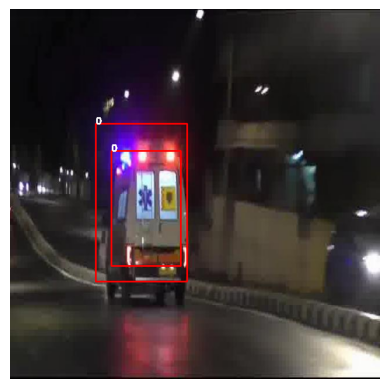

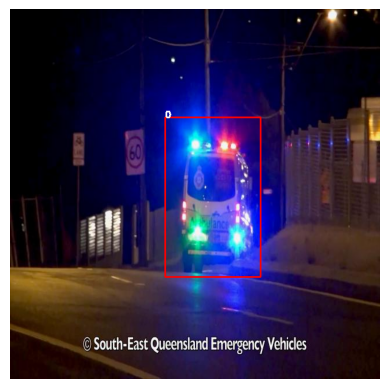

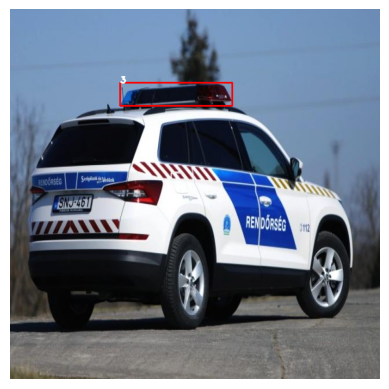

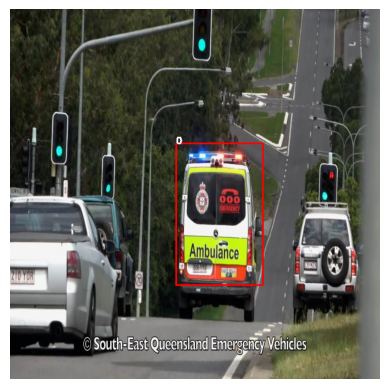

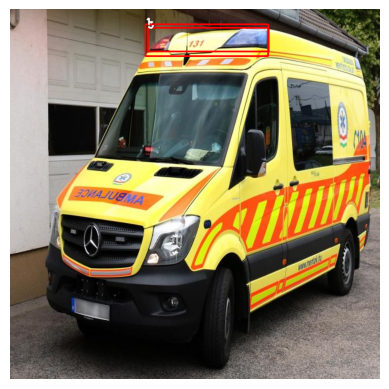

...

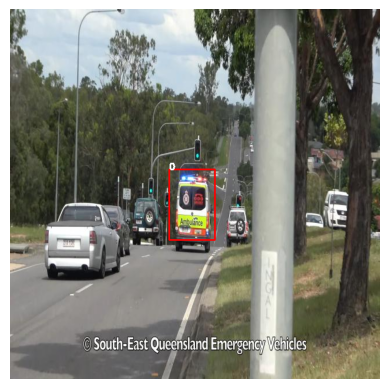

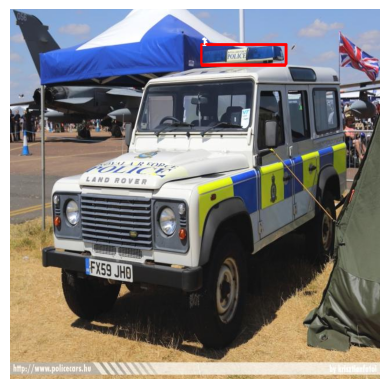

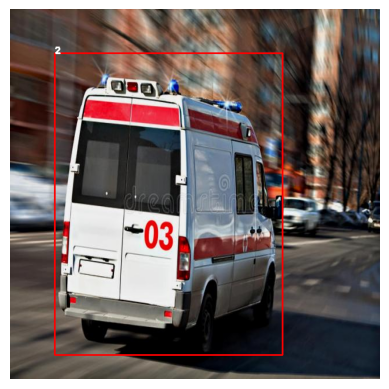

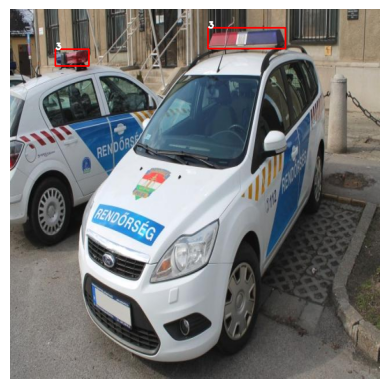

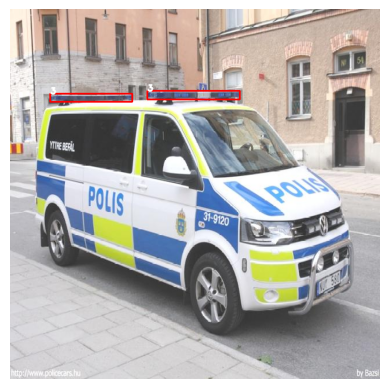

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

def display_image_with_label(image_path, label_path):
    # Load the image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Read the label file
    with open(label_path, 'r') as file:
        labels = file.readlines()

    # Draw bounding boxes on the image
    for label in labels:
        class_id, x_center, y_center, width, height = map(float, label.split())
        class_id = int(class_id)

        # Convert from YOLO format to pixel format
        img_height, img_width, _ = image.shape
        x_center *= img_width
        y_center *= img_height
        width *= img_width
        height *= img_height

        # Calculate the top-left and bottom-right coordinates
        top_left = (int(x_center - width / 2), int(y_center - height / 2))
        bottom_right = (int(x_center + width / 2), int(y_center + height / 2))

        # Draw the bounding box
        cv2.rectangle(image_rgb, top_left, bottom_right, (255, 0, 0), 2)

        # Optionally, display the class name
        cv2.putText(image_rgb, str(class_id), top_left, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    # Display the image with bounding boxes
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

# Specify the paths to the training images and labels
train_images_dir = "/content/Emergency-Siren-1/train/images"
train_labels_dir = "/content/Emergency-Siren-1/train/labels"


# Get a list of all image files
image_files = [f for f in os.listdir(train_images_dir) if os.path.isfile(os.path.join(train_images_dir, f))]

# Randomly select 10 images
sample_images = random.sample(image_files, 40)

# Display each image and its corresponding label
for image_file in sample_images:
    image_path = os.path.join(train_images_dir, image_file)
    label_path = os.path.join(train_labels_dir, image_file.replace(".jpg", ".txt").replace(".jpeg", ".txt").replace(".png", ".txt"))

    display_image_with_label(image_path, label_path)


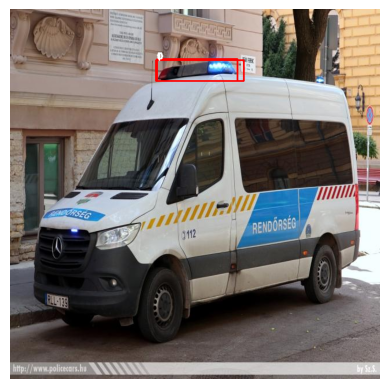

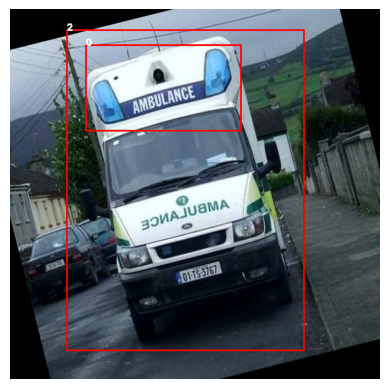

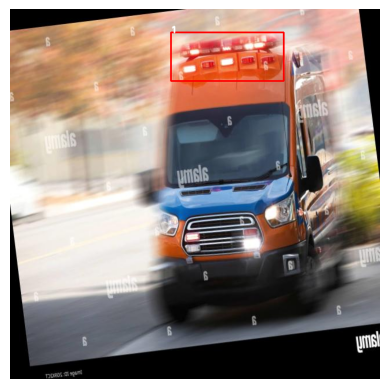

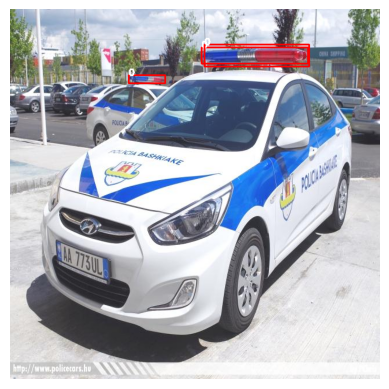

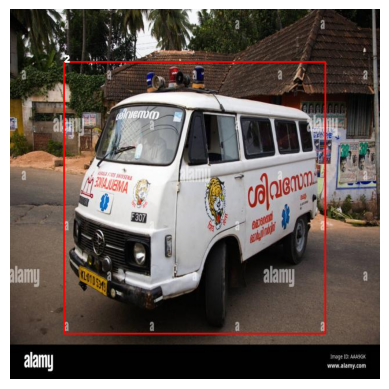

...

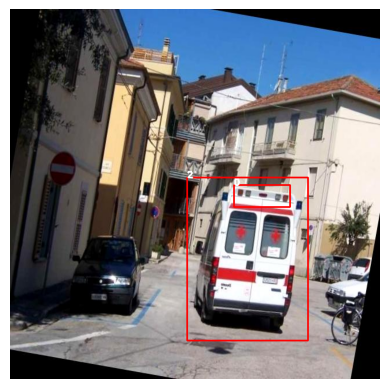

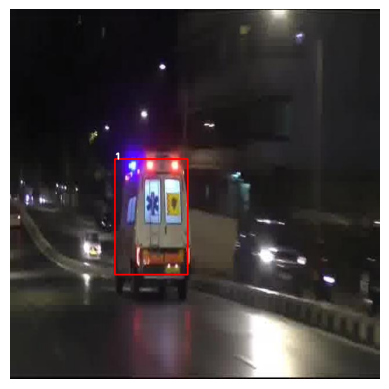

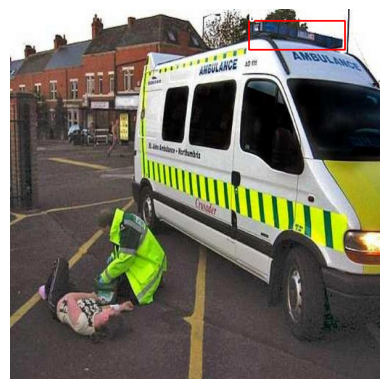

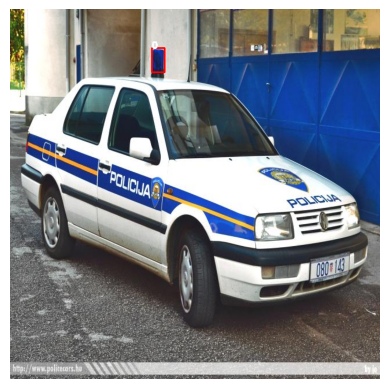

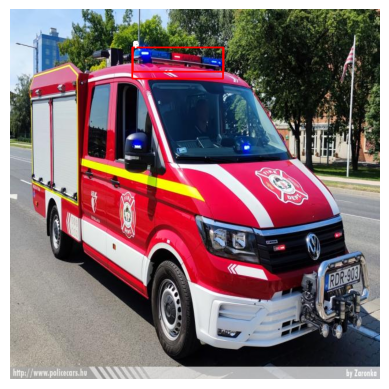

In [ ]:
import os
import random
import matplotlib.pyplot as plt
import cv2

def display_image_with_label(image_path, label_path):
    # Load the image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Read the label file
    with open(label_path, 'r') as file:
        labels = file.readlines()

    # Draw bounding boxes on the image
    for label in labels:
        class_id, x_center, y_center, width, height = map(float, label.split())
        class_id = int(class_id)

        # Convert from YOLO format to pixel format
        img_height, img_width, _ = image.shape
        x_center *= img_width
        y_center *= img_height
        width *= img_width
        height *= img_height

        # Calculate the top-left and bottom-right coordinates
        top_left = (int(x_center - width / 2), int(y_center - height / 2))
        bottom_right = (int(x_center + width / 2), int(y_center + height / 2))

        # Draw the bounding box
        cv2.rectangle(image_rgb, top_left, bottom_right, (255, 0, 0), 2)

        # Optionally, display the class name
        cv2.putText(image_rgb, str(class_id), top_left, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    # Display the image with bounding boxes
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

# Specify the paths to the training images and labels
train_images_dir = "/content/Combined-Dataset/images"
train_labels_dir = "/content/Combined-Dataset/labels"


# Get a list of all image files
image_files = [f for f in os.listdir(train_images_dir) if os.path.isfile(os.path.join(train_images_dir, f))]

# Randomly select 10 images
sample_images = random.sample(image_files, 40)

# Display each image and its corresponding label
for image_file in sample_images:
    image_path = os.path.join(train_images_dir, image_file)
    label_path = os.path.join(train_labels_dir, image_file.replace(".jpg", ".txt").replace(".jpeg", ".txt").replace(".png", ".txt"))

    display_image_with_label(image_path, label_path)


In [ ]:
import shutil

# Path to the folder you want to zip
folder_to_zip = "Combined-Dataset"
zip_filename = "Combined-Dataset.zip"

# Create a zip file
shutil.make_archive(zip_filename.replace(".zip", ""), 'zip', folder_to_zip)

print(f"Zipped {folder_to_zip} into {zip_filename}.")


Zipped Combined-Dataset into Combined-Dataset.zip.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Specify the path where you want to upload it in Google Drive
drive_path = "/content/drive/MyDrive/Combined-Dataset.zip"

# Move the zip file to the shared Google Drive folder
shutil.move(zip_filename, drive_path)

print(f"Uploaded {zip_filename} to Google Drive at {drive_path}.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Uploaded Combined-Dataset.zip to Google Drive at /content/drive/MyDrive/Combined-Dataset.zip.


In [ ]:
from collections import Counter

def count_class_instances(labels_dir):
    class_counts = Counter()
    for label_file in os.listdir(labels_dir):
        label_path = os.path.join(labels_dir, label_file)
        with open(label_path, 'r') as f:
            lines = f.readlines()
            for line in lines:
                class_id = int(line.strip().split()[0])
                class_counts[class_id] += 1
    return class_counts

In [ ]:
combined_labels_dir = '/content/Combined-Dataset/labels'
class_counts = count_class_instances(combined_labels_dir)

In [ ]:
class_names = ['siren_off', 'siren_on', 'emergency_car']

print("Class Distribution in Combined Dataset:")
for class_id, count in class_counts.items():
    print(f'Class {class_id} ({class_names[class_id]}): {count} instances')

combined_labels_dir = 'Combined-Dataset/labels'
class_counts = count_class_instances(combined_labels_dir)
class_names = ['siren_off', 'siren_on', 'emergency_car']


Class Distribution in Combined Dataset:
Class 2 (emergency_car): 351 instances
Class 1 (siren_on): 603 instances
Class 0 (siren_off): 1230 instances
